# Object Detection (Faster R-CNN) - [People, Cats and Dogs]
---------------
This Notebook walks you through how to use this Python project to do object detection (Tensorflow & Keras). This is in essence a custom implementation of the Faster R-CNN (Region-based Convolutional Neural Network), which is a single-staged object detector. In this case, I have trained the models to do object detection on images and videos of people, cats and dogs.

In [1]:
# import statements
import os
os.environ["TF_FORCE_GPU_ALLOW_GROWTH"]='true'
import random
import numpy as np
import cv2 as cv
import datetime
import tensorflow as tf

from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Rescaling, Conv2D, MaxPooling2D, GlobalMaxPooling2D, Dense, Dropout, RandomFlip
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam, SGD

from sklearn.cluster import KMeans
from matplotlib import pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
from tqdm import tqdm

from faster_rcnn import *

#### The /datasets/ Folder
This project has a /datasets/ folder which contains the datasets that can be used for training the object detection models. Each /datasets/ subdirectory holds a dataset and each dataset folder, in turn, has an /images/ and an /annotations/ folder. The images are naturally stored in the /images/ subdirectory and the annotations are stored in the /annotations/ subdirectory. The annotations are stored in PASCAL VOC XML format.
You can easily add, remove, or replace datasets to adjust the scope of the object detection.

In [2]:
# list the datasets present in the datasets folder
datasets = os.listdir(os.getcwd() + '/datasets/')
print('Available Datasets: ' + str(datasets))

Available Datasets: ['Asirra Cats vs Dogs Object Detection Dataset', 'Cats and Dogs for Object Detection', 'Person Face Detection']


In [3]:
# combine datasets
X, Y = combine_datasets(['Cats and Dogs for Object Detection', 
                         'Asirra Cats vs Dogs Object Detection Dataset', 
                         'Person Face Detection'])
random.sample(X, 10) # explore a sample of the paths to the images in the combined dataset

['Cats and Dogs for Object Detection/images/leonberger_177.jpg',
 'Person Face Detection/images/34_Baseball_Baseball_34_570.jpg',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test3091.png',
 'Cats and Dogs for Object Detection/images/Birman_116.jpg',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test943.png',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test2781.png',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test2885.png',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test630.png',
 'Asirra Cats vs Dogs Object Detection Dataset/images/Cats_Test1538.png',
 'Person Face Detection/images/13_Interview_Interview_Sequences_13_633.jpg']

In [4]:
# Search through the dataset and find all the class labels.
# The class labels hyperparameter (CLASSES) can be a subset of all the class labels 
# present within the dataset as they will be filtered out
CLASSES = get_classes(Y)
print('CLASSES: ' + str(CLASSES))

100%|█████████████████████████████████████████████████████████████████████████████| 9881/9881 [00:13<00:00, 740.70it/s]

CLASSES: ['cat', 'dog', 'person']


## Inspect Dataset
It is important to inspect the dataset characteristics that can influence the performance of the object detection model.

#### 1.) Class Label Distribution
Evaluating a class label distribution can help us gauge whether we are dealing with class label imbalance, which could lead the model to predict the overrepresented class labels more often than we want (after all it would be the fastest way for the model to reduce its class loss significantly).

#### 2.) Image Width-to-Height Ratio Distribution
Furthermore, examining a width-to-height ratio distribution can help with determining which model input dimensions are optimal. We want to minimize image and thus also object distortions due to resizing because it makes it more challenging for the model to extract features that help to fit and generalize from the data.

#### 3.) Anchor Box Selection
This model works by placing a set of predetermined anchor boxes at every point within a equally spaced out grid overlaying the images. Anchors are then assigned to objects based on IoU (degree of overlap) and targets for the network are established by calculating offset variables for the bounding box dimensions. Hence, the network can benefit from choosing "good" priors, which should make the job of fitting the predicted bounding boxes to the underlying ground truth bounding boxes easier.

#### 4.) Visual Inspection
Visually inspecting the data and the corresponding annotations are the most important of all. Only by going through multiple samples of the data, can we judge the presence of anomalies. Inconsistent annotation labelling in the way objects are labelled or leaving out objects all together, can severly hamper the model's ability to fit the data if the problem is large enough within the overall dataset.

### 1.) Sample Class Label Distribution

100%|████████████████████████████████████████████████████████████████████████████| 2000/2000 [00:00<00:00, 9414.77it/s]


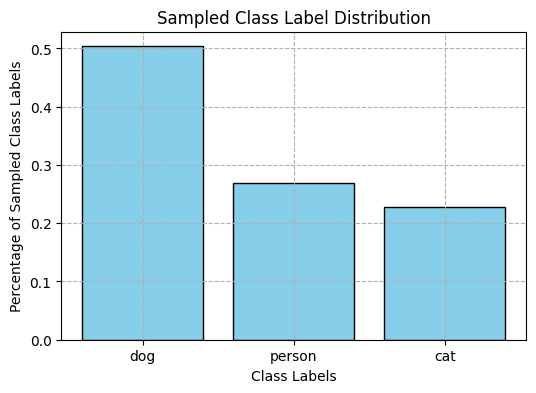

In [5]:
# Sample Class Label Distribution
class_distribution = sample_class_distribution(xml_filenames = Y, 
                                               sample_size = 2000, 
                                               classes = CLASSES, 
                                               min_obj_surface = 0.0)
plt.figure(figsize = (6,4))
plt.bar(class_distribution.keys(), class_distribution.values(), color = 'skyblue', edgecolor='black')
plt.title('Sampled Class Label Distribution')
plt.xlabel('Class Labels')
plt.ylabel('Percentage of Sampled Class Labels')
plt.grid(True, linestyle = '--')

### 2.) Sample Width-to-Height Ratio Distribution

100%|████████████████████████████████████████████████████████████████████████████| 2000/2000 [00:00<00:00, 9459.61it/s]


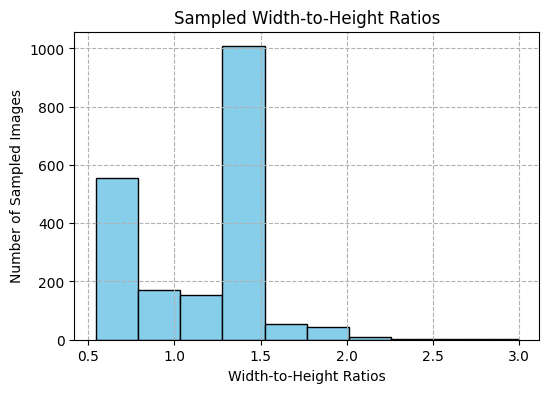

In [6]:
# Sample Width-to-Height Ratios
sample_size = 2000
width_to_height_ratios = sample_width_to_height_ratios(xml_filenames = Y, sample_size = sample_size)
plt.figure(figsize = (6,4))
plt.hist(width_to_height_ratios, color = 'skyblue', edgecolor='black', bins = 10)
plt.title('Sampled Width-to-Height Ratios')
plt.xlabel('Width-to-Height Ratios')
plt.ylabel('Number of Sampled Images')
plt.grid(True, linestyle = '--')

### 3.) Selecting Anchor Box Priors through Clustering

100%|████████████████████████████████████████████████████████████████████████████| 9881/9881 [00:01<00:00, 9382.05it/s]


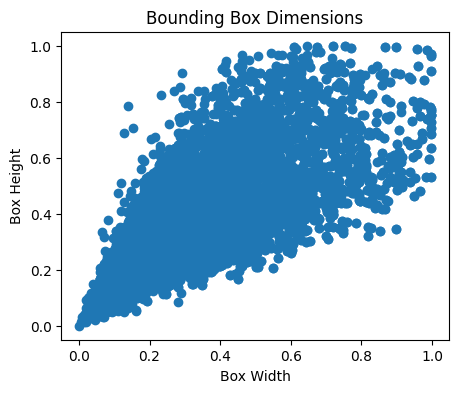

In [7]:
# Bounding Box Clustering
bbox_widths, bbox_heights = get_bbox_dims(label_pathnames = Y, classes = CLASSES)
plt.figure(figsize = (5,4))
plt.title('Bounding Box Dimensions')
plt.xlabel('Box Width')
plt.ylabel('Box Height')
plt.scatter(bbox_widths, bbox_heights)
plt.show()

100%|██████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  9.63it/s]


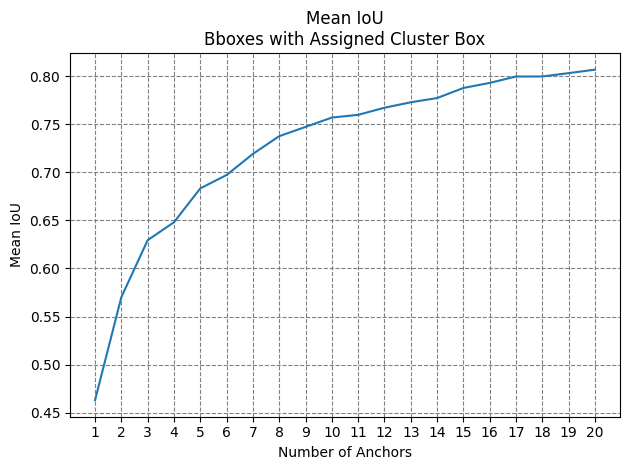

In [8]:
n = 20 # number of anchors up to which we would like to evaluate bounding box-anchor mean IoU
mean_ious = mean_IoU_by_number_of_anchors(n = n, bbox_widths = bbox_widths, bbox_heights = bbox_heights)

#plt.figure(figsize = (5,4))
plt.plot(range(1,n+1), mean_ious)
plt.xticks(range(1,n+1))
plt.grid(color='grey', linestyle='--')
plt.title('Mean IoU\nBboxes with Assigned Cluster Box')
plt.xlabel('Number of Anchors')
plt.ylabel('Mean IoU')
plt.tight_layout()
plt.show()

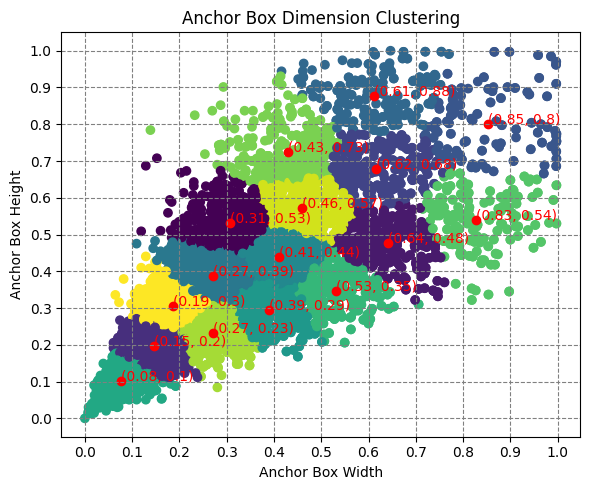

ANCHOR BOX CLUSTERS (HEIGHT, WIDTH)
Coordinates are image relative [0,1]
[[0.5302353  0.30783978]
 [0.47623344 0.64046435]
 [0.19544831 0.14729718]
 [0.67843817 0.61675272]
 [0.80092545 0.85272759]
 [0.87546347 0.61256503]
 [0.38657    0.2715907 ]
 [0.43767445 0.41047772]
 [0.29339998 0.38970633]
 [0.10060182 0.07684707]
 [0.34759431 0.5317569 ]
 [0.53852608 0.82667484]
 [0.72523174 0.42932537]
 [0.23216147 0.27194297]
 [0.57336847 0.4603221 ]
 [0.30457063 0.18701154]]


In [9]:
number_of_anchors = 16

kmeans = KMeans(n_clusters = number_of_anchors, n_init = 10, random_state = 5)
kmeans.fit(list(zip(bbox_heights, bbox_widths)))

plt.figure(figsize = (6,5))
plt.grid(color='grey', linestyle='--')
plt.title('Anchor Box Dimension Clustering')
plt.xlabel('Anchor Box Width')
plt.ylabel('Anchor Box Height')
plt.xticks(np.arange(0, 1.1, 0.1))
plt.yticks(np.arange(0, 1.1, 0.1))
plt.scatter(bbox_widths, bbox_heights, c = kmeans.labels_)
plt.scatter(kmeans.cluster_centers_[:,1], kmeans.cluster_centers_[:,0], c = 'red')
for i in range(kmeans.cluster_centers_.shape[0]):
    plt.text(x = kmeans.cluster_centers_[i,1], 
             y = kmeans.cluster_centers_[i,0], 
             s = '(' + str(np.round(kmeans.cluster_centers_[i,1], 2)) + 
                 ', ' + str(np.round(kmeans.cluster_centers_[i,0], 2)) + ')',
             c = 'red')
plt.tight_layout()
plt.show()

print('ANCHOR BOX CLUSTERS (HEIGHT, WIDTH)')
print('Coordinates are image relative [0,1]')
ANCHORS = kmeans.cluster_centers_

print(ANCHORS)

### 4.) Visual Inspection of Dataset

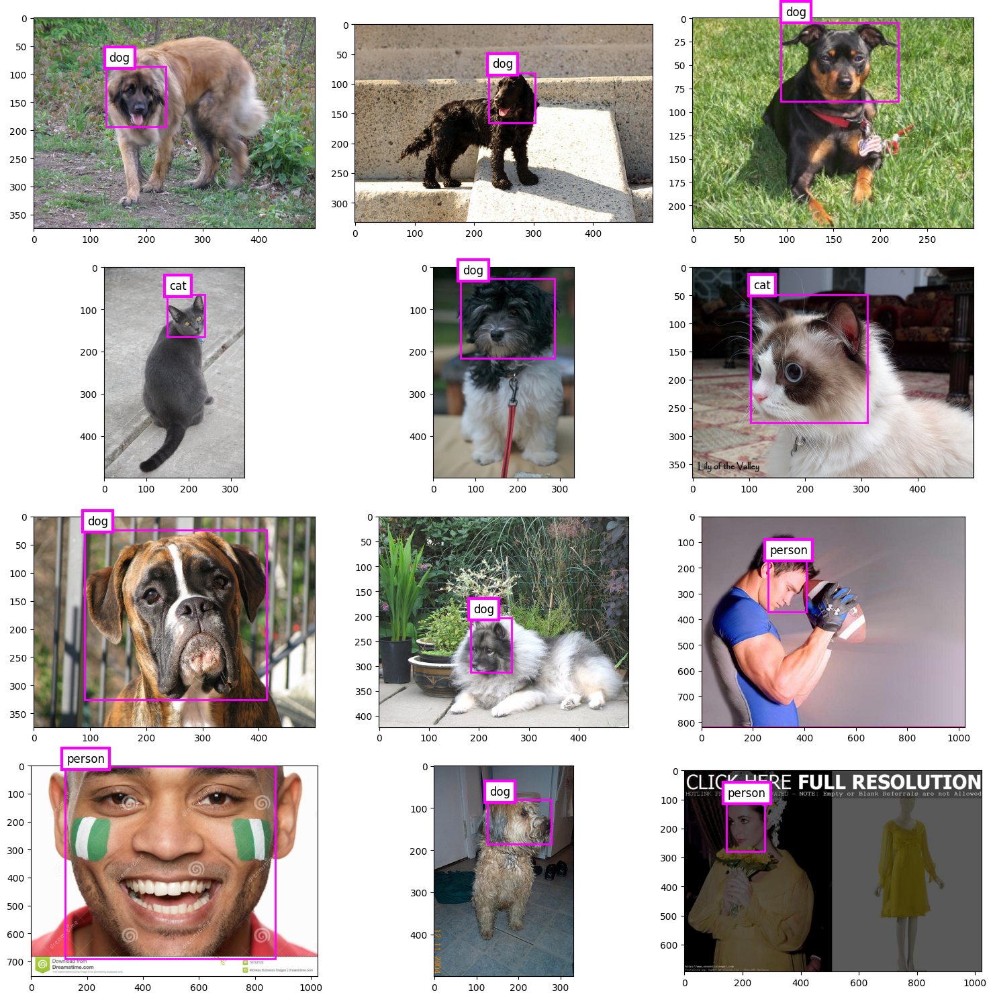

In [10]:
# VISUAL INSPECTION OF DATA SAMPLE
plt.figure(figsize = (15,15))
sampled_indices = np.random.choice(range(len(X)), 12, replace = False)
for i in range(0, 12, 1):
    ax = plt.subplot(4, 3, i+1)
    show_xml_annotation(xml_file = Y[sampled_indices[i]],
                        boxcolor = 'fuchsia',
                        boxborderwidth = 2,
                        boxborderstyle = '-',
                        fontsize = 12.0,
                        labelcolor = 'black',
                        labelbackgroundcolor = 'white',
                        labelbordercolor = 'fuchsia',
                        labelborderwidth = 3,
                        labelborderstyle = '-',
                        labelpadding = 5.0,
                        alpha = 0.0,
                        box_filled = False)
    pass
plt.tight_layout()
plt.show()

--------------------------------------

### Hyperparameters

In [11]:
# HYPERPARAMETERS
params = {'IMG_H': 448, # model input: image height
          'IMG_W': 448, # model input: image width
          'CHANNELS': 3, # model input: image color channels
          'GRID_H': 28, # vertical grid cells as layout for the anchor coordinates = 448 / 32.0
          'GRID_W': 28, # horizontal grid cells as layout for the anchor coordinates = 448 / 32.0
          'BATCH_SIZE': 8, # batch size for training
          'ANCHOR_DIMS': [25, 50, 100, 150, 200, 250, 300, 350, 400], # anchor dimensions (pixels)
          'ASPECT_RATIOS': [0.5, 1.0, 1.5],
          'ALLOW_OUT_OF_BOUNDS_ANCHORS': True,
          'ROI_RESOLUTION': (128, 128),
          'CLASSES': CLASSES, # inferred from data
          'CLASS_COLORS': ['blue', 'red', 'green']} # we will assign when we know the classes

augment_params = {'translate': 0.2,
                  'noise': 0.05,
                  'contrast': 0.25,
                  'brightness': 0.2,
                  'zoom': 0.2,
                  'blur': 0.2}

------------------

### Train/Test Split on the Dataset

In [12]:
# TRAIN-VALIDATION SPLIT
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.05, random_state = 25)

if isinstance(X_train, list):
    print('X_train size: ', str(len(X_train)))
    print('Y_train size: ', str(len(Y_train)))
    print('X_test size: ', str(len(X_test)))
    print('Y_test size: ', str(len(Y_test)))
else:
    print('X_train shape: ', str(X_train.shape))
    print('Y_train shape: ', str(Y_train.shape))
    print('X_test shape: ', str(X_test.shape))
    print('Y_test shape: ', str(Y_test.shape))

X_train size:  9386
Y_train size:  9386
X_test size:  495
Y_test size:  495


---------------

### Preprocessing With or Without Data Augmentation

##### Preprocessing

Preprocessing is done by reading in the image and annotation paths, resizing the image to the desired input dimensions, and returning ground truth object locations and classes. 

##### Data Augmentation

Data augmentation helps the model generalize from the training data to 'unseen' test data. Without augmentation, sufficiently sophisticated models can simply "memorize" specific training examples instead of learning how to recognize and locate the objects within the image based on object features. This is called overfitting.

Implementing image augmentation by adjusting the factors for hue, contrast, brightness and saturation are fairly straightforward as they do not involve changing the location of the objects within the image and thus changing the bounding box coordinates for the model target labels. However, introducing random translations will change the location of the objects relative to the resulting image, which makes it a little more involved.   

In [13]:
# select an index
index = 1

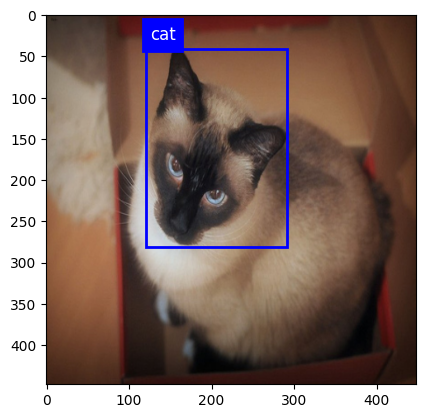

In [14]:
# testing preprocess function (without augmentation)
show_preprocessed_img(ind = index,
                      X = X_train, 
                      Y = Y_train, 
                      params = params,
                      augment_params = None,
                      fontsize = 12, 
                      boxborderwidth = 2, 
                      box_filled = False,
                      labelcolor = 'white', 
                      labelbackgroundcolor = 'blue',
                      labelborderwidth = 2,
                      labelpadding = 5.0,
                      alpha = 0.3)

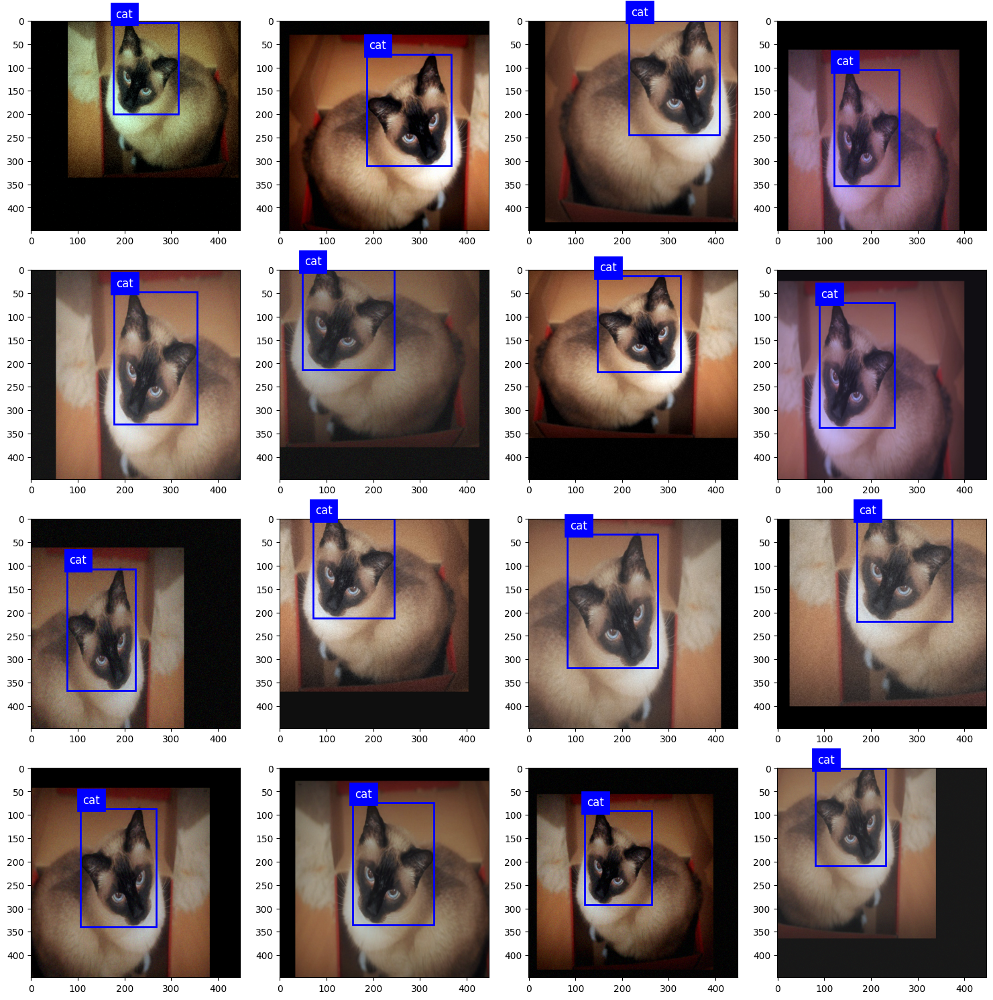

In [15]:
# testing preprocess function (with augmentation)
plt.figure(figsize = (15,15))
for j in range(0, 16, 1):
    ax = plt.subplot(4, 4, j+1)
    show_preprocessed_img(ind = index,
                          X = X_train, 
                          Y = Y_train, 
                          params = params,
                          augment_params = augment_params, # NOTE that we pass in the augmentation parameters here!
                          fontsize = 12, 
                          boxborderwidth = 2,
                          boxborderstyle = '-',
                          box_filled = False,
                          labelcolor = 'white', 
                          labelbackgroundcolor = 'blue',
                          labelborderwidth = 2,
                          labelborderstyle = '-',
                          labelpadding = 5.0,
                          alpha = 0.3)
    pass
    
plt.tight_layout()
plt.show()

## Region Proposal Network (RPN)
------
Region Proposal Networks (RPNs), like the ones employed in Faster R-CNN models, use a set of anchors (boxes with a predetermined height and width) that are placed at evenly spaced-out grid locations within the image. It is then determined which of these anchors have a high enough overlap (IoU) with an underlying ground truth object within the image. For these anchors, offsets (regression deltas) are calculated which provide us with the regression targets for the network. 

In [16]:
# preprocess an image for which we can demonstrate how the region proposal network works
img, objs, cls = preprocess(image = X_train[index], 
                            label = Y_train[index], 
                            params = params)

In [17]:
# the anchor_mapping function places these anchors within the grid overlying the image
anchor_map, inbounds_map = anchor_mapping(params)

print('----------------')
print('Inbounds Map Shape: ', inbounds_map.shape) # True if anchor is inbounds, False if not inbounds
print('Anchor Map [xmid, ymid, w, h] Shape: ', anchor_map.shape) # [xmid, ymid, w, h] for each anchor
print('----------------')

----------------
Inbounds Map Shape:  (1, 28, 28, 27, 1)
Anchor Map [xmid, ymid, w, h] Shape:  (1, 28, 28, 27, 4)
----------------


In [18]:
# based on hyperparameters, anchors that go outside the bounds of the underlying image might be considered invalid
valid_anchor_map = anchor_map * inbounds_map

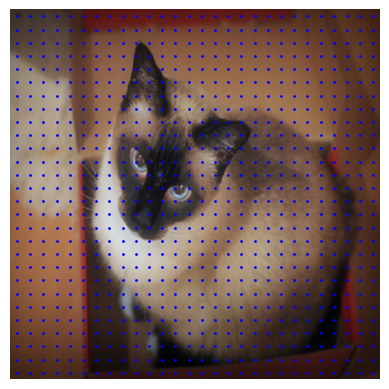

In [19]:
# showing grid points which serve as mid-points for the anchors
for h in range(valid_anchor_map.shape[1]):
    for w in range(valid_anchor_map.shape[2]):
        plt.scatter(anchor_map[0,h,w,0,0], anchor_map[0,h,w,0,1], c = 'blue', s = 1)
        pass
    pass

plt.axis('off')
plt.imshow(img)
plt.show()

Below we can see a sample of anchor boxes centered around their grid points are put over the image:


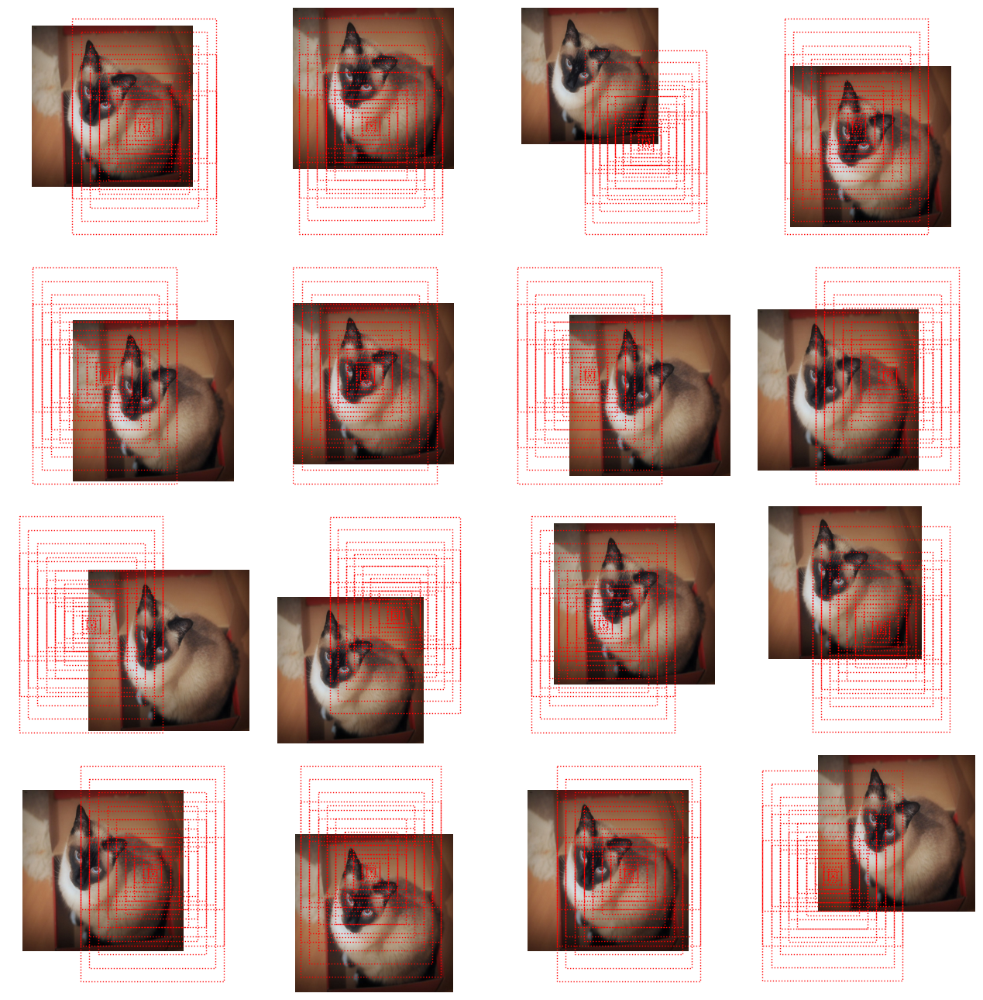

In [20]:
# show sample of valid (inbound) anchors around midpoints
print('Below we can see a sample of anchor boxes centered around their grid points are put over the image:')

plt.figure(figsize = (13,13))
for i in range(0, 16, 1):
    ax = plt.subplot(4, 4, i+1)
    h, w = random.randint(0, params['GRID_H']-1), random.randint(0, params['GRID_W']-1)

    plt.axis('off')
    plt.imshow(img)
    plt.scatter(valid_anchor_map[0,h,w,0,0], valid_anchor_map[0,h,w,0,1], c = 'red', s = 1)

    for a in range(len(params['ANCHOR_DIMS'])*len(params['ASPECT_RATIOS'])):
        if np.all(valid_anchor_map[0,h,w,a,:] > 0):
            plt.gca().add_patch(Rectangle((valid_anchor_map[0,h,w,a,0] - valid_anchor_map[0,h,w,a,2]/2, 
                                           valid_anchor_map[0,h,w,a,1] - valid_anchor_map[0,h,w,a,3]/2), 
                                          valid_anchor_map[0,h,w,a,2], 
                                          valid_anchor_map[0,h,w,a,3], 
                                          linewidth = 1,
                                          linestyle = ':',
                                          edgecolor = 'red',
                                          facecolor = 'none'))
            pass
        pass
plt.tight_layout()
plt.show()

For each gridpoint-anchor pairing, we can calculate the IoU with any of the ground truth boxes within the image. If the IoU is high enough the gridpoint box gets assigned to the underlying ground truth object and a set of offset regression variables is calculated. When the gridpoint boxes are adjusted by their regression variables, they perfectly correspond with their assigned ground truth bounding box.

100%|████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.79it/s]


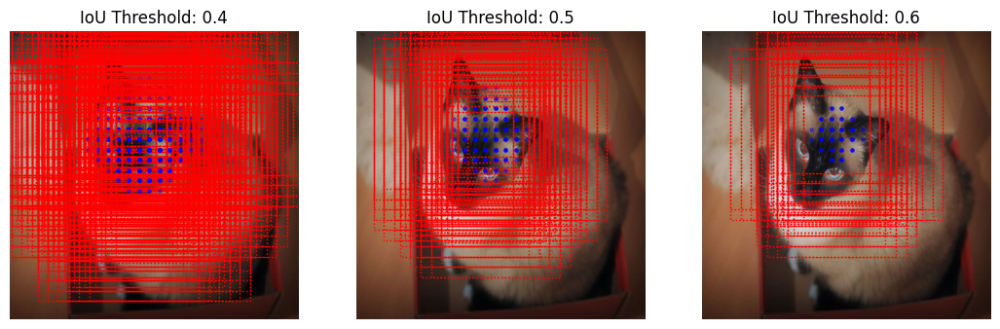

In [21]:
# we have to define a threshold IoU, which determines the cutoff point for which boxes are assigned to the ground truth objects
foreground_IoU_thresholds = [0.4, 0.5, 0.6]

plt.figure(figsize = (13,13))

for i in tqdm(range(len(foreground_IoU_thresholds))):
    ax = plt.subplot(1, len(foreground_IoU_thresholds), i+1)
    
    # the rpn_mapping function takes the anchors and holds them against the ground truth objects to see which of the anchors 
    # are assigned to which of the underlying objects within the image
    rpn_gt_conf, rpn_gt_deltas, indices = rpn_mapping(anchor_map = anchor_map, 
                                                      inbounds_map = inbounds_map, 
                                                      gt_boxes = objs, 
                                                      foreground_IoU_threshold = foreground_IoU_thresholds[i], # IoU threshold to be exceeded before anchor is assigned to object
                                                      params = params)
    
    
    plt.title('IoU Threshold: ' + str(foreground_IoU_thresholds[i]))
    
    for i in range(len(indices)):
        hi, wi, ai = indices[i,1:-1]    
        plt.scatter(anchor_map[0,hi,wi,0,0], anchor_map[0,hi,wi,0,1], c = 'blue', alpha = 0.4, s = 5.0)
        plt.gca().add_patch(Rectangle((valid_anchor_map[0,hi,wi,ai,0] - valid_anchor_map[0,hi,wi,ai,2]/2, # x min
                                       valid_anchor_map[0,hi,wi,ai,1] - valid_anchor_map[0,hi,wi,ai,3]/2), # y min
                                       valid_anchor_map[0,hi,wi,ai,2], # width
                                       valid_anchor_map[0,hi,wi,ai,3], # height
                                       linewidth = 1,
                                       linestyle = ':',
                                       edgecolor = 'red',
                                       facecolor = 'none'))
        pass
    
    plt.axis('off')
    plt.imshow(img)

plt.show()

In [22]:
# we can settle for an IoU threshold of 0.5
foreground_IoU_threshold = 0.5

In [23]:
# # sanity check to make sure that the assigned anchors adjusted by their offset regression variables correspond to a ground truth object
# print('Ground Truth coordinates: ' + str(objs))
# print(' ')
# for i in range(len(indices)):
#     hi, wi, ai = indices[i,1:-1]
#     print('xmin: ' + str(np.round(rpn_gt_deltas[0,hi,wi,ai,0] * valid_anchor_map[0,hi,wi,ai,2] + valid_anchor_map[0,hi,wi,ai,0], 4)) + 
#           '| ymin: ' + str(np.round(rpn_gt_deltas[0,hi,wi,ai,1] * valid_anchor_map[0,hi,wi,ai,3] + valid_anchor_map[0,hi,wi,ai,1], 4)) +
#           '| width: ' + str(np.round(np.exp(rpn_gt_deltas[0,hi,wi,ai,2]) * valid_anchor_map[0,hi,wi,ai,2], 4)) + 
#           '| height: ' + str(np.round(np.exp(rpn_gt_deltas[0,hi,wi,ai,3]) * valid_anchor_map[0,hi,wi,ai,3], 4)))

### Training the Region Proposal Model (RPN) to find our Region of Interests (ROI's)

In [24]:
# testing the RPN data generator
train_gen = rpn_data_generator(images = X_train, 
                               labels = Y_train,
                               params = params, 
                               augment_params = None, # if augment_params is None, no augmentation is applied
                               foreground_IoU_threshold = foreground_IoU_threshold,
                               batch_size = 8) 
[x_img], [y_conf, y_deltas] = train_gen.__getitem__(0)


print('----------------------')
print('INPUTS:')
print('Images: ', x_img.shape)
print('----------------------')
print('TARGETS:')
print('RPN conf target Shape: ', y_conf.shape)
print('RPN deltas target [tx, ty, tw, th] Shape: ', y_deltas.shape)

----------------------
INPUTS:
Images:  (8, 448, 448, 3)
----------------------
TARGETS:
RPN conf target Shape:  (8, 28, 28, 27, 1)
RPN deltas target [tx, ty, tw, th] Shape:  (8, 28, 28, 27, 4)


In [25]:
###### BACKBONE FEATURE EXTRACTOR ########
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

vgg16 = VGG16(include_top = False, 
              weights = 'imagenet', 
              input_shape = (params['IMG_H'], params['IMG_W'], params['CHANNELS']))
VGG16 = Model(inputs = [vgg16.input], 
              outputs = [vgg16.get_layer('block5_conv3').output],
              name = 'VGG_16')

i = Input([params['IMG_H'], params['IMG_W'], params['CHANNELS']], name = 'backbone_input')
x = tf.cast(i, tf.float32)
x = preprocess_input(x)
x = VGG16(x)

backbone = Model(inputs=[i], outputs=[x], name = 'VGG16')

backbone.trainable = False # we freeze the backbone's weights

print(backbone.summary())

Model: "VGG16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 backbone_input (InputLayer)  [(None, 448, 448, 3)]    0         
                                                                 
 tf.cast (TFOpLambda)        (None, 448, 448, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 448, 448, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 448, 448, 3)      0         
                                                                 
 VGG_16 (Functional)         (None, 28, 28, 512)       14714688  
                                                                 
Total params: 14,714,688
Trainable params: 0
Non-trainable params: 14,714,688
_________________________________________________

In [26]:
# # BACKBONE FEATURE EXTRACTOR MODEL
# from tensorflow.keras.applications import MobileNet
# from tensorflow.keras.applications.mobilenet import preprocess_input

# MN = MobileNet(weights = None,
#                include_top = False, 
#                input_shape = (params['IMG_H'], params['IMG_W'], params['CHANNELS']))
# MN = Model(inputs = [MN.input], 
#            outputs = [MN.get_layer('conv_pw_11_relu').output], 
#            name = 'MobileNet_model')

# i = Input([params['IMG_H'], params['IMG_W'], params['CHANNELS']])
# x = tf.cast(i, tf.float32)
# x = preprocess_input(x)
# x = MN(x)
# backbone = Model(inputs=[i], outputs=[x], name = 'MobileNet')
# print(backbone.summary())

In [27]:
# create the region proposal network heads for the bounding box regression and confidence score predictions
rpn = RPN_heads(regression_filters = [512, 1024, 1024, 512], 
                confidence_filters = [512, 1024, 1024, 512, 256],
                params = params,
                name = 'RPN_Head')

In [28]:
# combine the backbone feature extractor with the RPN heads
RPN = init_RPN_model(backbone = backbone,
                     rpn_heads = rpn, 
                     params = params)

print(RPN.summary())

Model: "RPN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 448, 448, 3)]     0         
                                                                 
 VGG16 (Functional)          (None, 28, 28, 512)       14714688  
                                                                 
 RPN_Head (RPN_heads)        ((None, 28, 28, 27, 1),   43741319  
                              (None, 28, 28, 27, 4))             
                                                                 
Total params: 58,456,007
Trainable params: 43,728,519
Non-trainable params: 14,727,488
_________________________________________________________________
None


In [29]:
# COMPILE MODEL
RPN.compile(Adam(learning_rate = 0.001, beta_1 = 0.9, beta_2 = 0.999, epsilon = 1e-08, decay = 0.0), #optimizer = 'sgd', #
            loss = {'RPN_Head': rpn_conf_loss, 'RPN_Head_1': rpn_box_loss})

# set up directory to store weights
if not os.path.exists('pretrained/weights/' + RPN.name):
    os.makedirs('pretrained/weights/' + RPN.name)
    pass

# construct a filename
filename = (RPN.name + '_' + backbone.name.upper() + '_reg_' +
            "".join(str(tuple(rpn.regression_filters))).replace(", ", "_") + '_conf_'+
            "".join(str(tuple(rpn.confidence_filters))).replace(", ", "_") + '_' +
            str(params['CLASSES'][:]) + '_model_(' + 
            datetime.datetime.now().strftime("%x") + 
            ').h5').replace('\'', '').replace('/', '-').replace(', ', '_')
print('Model weights will be saved under: ')
print(filename)

# CALLBACKS
checkpoint = ModelCheckpoint(filepath = 'pretrained/weights/' + RPN.name + '/' + filename,
                             monitor = "val_loss",
                             verbose = 0, 
                             save_best_only = True, 
                             save_weights_only = True)

early_stopping = EarlyStopping(monitor = "loss",
                               min_delta = 0,
                               patience = 5,
                               verbose = 1,
                               mode = "auto",
                               restore_best_weights = True)

# LEARNING RATE SCHEDULE
def custom_schedule(epoch):
    if epoch >= 0 and epoch <= 2:
        return 0.00001
    elif epoch > 2 and epoch <= 4:
        return 0.0001
    elif epoch > 4 and epoch <= 80:
        return 0.001
    elif epoch > 120:
        return 0.0001

lr_scheduler = tf.keras.callbacks.LearningRateScheduler(schedule = custom_schedule, verbose = 0)

Model weights will be saved under: 
RPN_VGG16_reg_(512_1024_1024_512)_conf_(512_1024_1024_512_256)_[cat_dog_person]_model_(07-10-24).h5


In [30]:
# custom saving & loading of model weights
RPN.load_weights('pretrained/weights/RPN/RPN_VGG16_reg_(512_1024_1024_512)_conf_(512_1024_1024_512_256)_[cat_dog_person]_model_(02-02-24).h5')

In [72]:
# training RPN
epochs = 140
history = RPN.fit(rpn_data_generator(images = X_train, 
                                     labels = Y_train, 
                                     params = params, 
                                     augment_params = augment_params,
                                     foreground_IoU_threshold = foreground_IoU_threshold,
                                     batch_size = 8),
                    epochs = epochs,
                    validation_data = rpn_data_generator(images = X_test, 
                                                         labels = Y_test, 
                                                         params = params,
                                                         augment_params = None,
                                                         foreground_IoU_threshold = foreground_IoU_threshold,
                                                         batch_size = 8),
                    verbose = 1,
                    callbacks = [checkpoint])

Epoch 1/140
1174/1174 [==============================] - 250s 203ms/step - loss: 0.0337 - RPN_Head_loss: 0.0289 - RPN_Head_1_loss: 0.0048 - val_loss: 0.0187 - val_RPN_Head_loss: 0.0183 - val_RPN_Head_1_loss: 4.1222e-04
Epoch 2/140
1174/1174 [==============================] - 171s 146ms/step - loss: 0.0148 - RPN_Head_loss: 0.0145 - RPN_Head_1_loss: 3.6075e-04 - val_loss: 0.0154 - val_RPN_Head_loss: 0.0149 - val_RPN_Head_1_loss: 4.8436e-04
Epoch 3/140
1174/1174 [==============================] - 171s 146ms/step - loss: 0.0136 - RPN_Head_loss: 0.0132 - RPN_Head_1_loss: 3.7918e-04 - val_loss: 0.0166 - val_RPN_Head_loss: 0.0162 - val_RPN_Head_1_loss: 4.4996e-04
Epoch 4/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0128 - RPN_Head_loss: 0.0124 - RPN_Head_1_loss: 3.9260e-04 - val_loss: 0.0150 - val_RPN_Head_loss: 0.0146 - val_RPN_Head_1_loss: 4.7860e-04
Epoch 5/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0120 - RPN_Head_loss: 0.0116 

Epoch 38/140
1174/1174 [==============================] - 170s 145ms/step - loss: 0.0066 - RPN_Head_loss: 0.0064 - RPN_Head_1_loss: 1.6402e-04 - val_loss: 0.0089 - val_RPN_Head_loss: 0.0086 - val_RPN_Head_1_loss: 2.3217e-04
Epoch 39/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0065 - RPN_Head_loss: 0.0064 - RPN_Head_1_loss: 1.6203e-04 - val_loss: 0.0085 - val_RPN_Head_loss: 0.0083 - val_RPN_Head_1_loss: 1.9413e-04
Epoch 40/140
1174/1174 [==============================] - 171s 146ms/step - loss: 0.0065 - RPN_Head_loss: 0.0063 - RPN_Head_1_loss: 1.5989e-04 - val_loss: 0.0092 - val_RPN_Head_loss: 0.0090 - val_RPN_Head_1_loss: 1.8942e-04
Epoch 41/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0064 - RPN_Head_loss: 0.0063 - RPN_Head_1_loss: 1.5906e-04 - val_loss: 0.0086 - val_RPN_Head_loss: 0.0084 - val_RPN_Head_1_loss: 1.8386e-04
Epoch 42/140
1174/1174 [==============================] - 170s 145ms/step - loss: 0.0064 - RPN_Head_loss

1174/1174 [==============================] - 173s 147ms/step - loss: 0.0049 - RPN_Head_loss: 0.0047 - RPN_Head_1_loss: 1.2374e-04 - val_loss: 0.0079 - val_RPN_Head_loss: 0.0078 - val_RPN_Head_1_loss: 1.4354e-04
Epoch 111/140
1174/1174 [==============================] - 170s 145ms/step - loss: 0.0048 - RPN_Head_loss: 0.0047 - RPN_Head_1_loss: 1.2189e-04 - val_loss: 0.0084 - val_RPN_Head_loss: 0.0082 - val_RPN_Head_1_loss: 1.5040e-04
Epoch 112/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0048 - RPN_Head_loss: 0.0047 - RPN_Head_1_loss: 1.2148e-04 - val_loss: 0.0079 - val_RPN_Head_loss: 0.0078 - val_RPN_Head_1_loss: 1.4132e-04
Epoch 113/140
1174/1174 [==============================] - 173s 147ms/step - loss: 0.0048 - RPN_Head_loss: 0.0047 - RPN_Head_1_loss: 1.2291e-04 - val_loss: 0.0086 - val_RPN_Head_loss: 0.0085 - val_RPN_Head_1_loss: 1.4371e-04
Epoch 114/140
1174/1174 [==============================] - 171s 145ms/step - loss: 0.0048 - RPN_Head_loss: 0.0047 

### Decode Region Proposal Network (RPN) Output

In [31]:
# create a RPN proposal extraction layer which converts RPN encoded prediction to box confidence scores and coordinates
extract_rpn_proposals_layer = Extract_RPN_Proposals(anchor_map = anchor_map, 
                                                    conf_thres = 0.6, 
                                                    nms_iou_thres = 0.2, 
                                                    nms_max_output_size = 100, 
                                                    background_iou_thres = 0.05, 
                                                    params = params,
                                                    name = "Extracting_RPN_Proposals")

### Evaluate Region Proposal Network (RPN) Performance

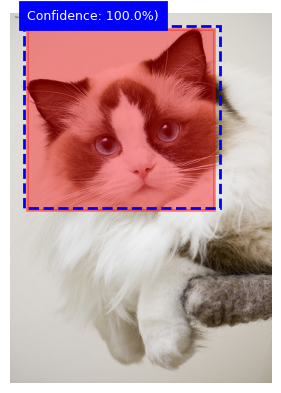

In [32]:
i = 1
show_RPN_performance(image = X_test[i], 
                     label = Y_test[i],
                     folder = '/datasets/', # NOTE that our image and label filenames are located in the dataset folder
                     RPN = RPN, 
                     extract_rpn_proposals_layer = extract_rpn_proposals_layer, 
                     params = params,
                     pred_color = 'blue', 
                     gt_color = 'red',
                     return_original_dimensions = True,
                     boxborderwidth = 2,
                     boxborderstyle = '--',
                     fontsize = 9,
                     labelcolor = 'white', 
                     labelbackgroundcolor = 'blue',
                     labelborderwidth = 2,
                     labelborderstyle = '-',
                     labelpadding = 5.0,
                     axisdrawn = False)

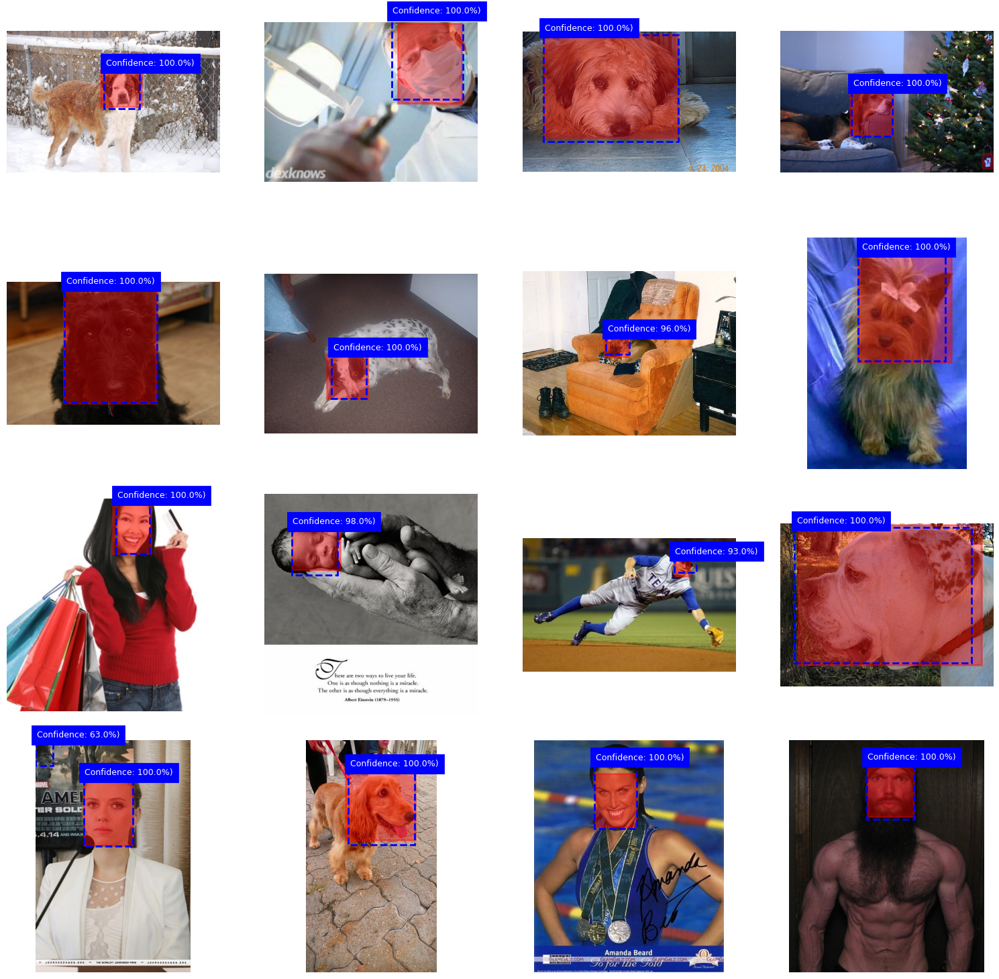

In [33]:
# evaluate RPN against TRAIN DATA
inds = np.random.choice(a = range(len(X_train)), size = 16, replace = False)
plt.figure(figsize = (15,15))
for i in range(0, 16, 1):
    ax = plt.subplot(4, 4, i+1)
    show_RPN_performance(image = X_train[inds[i]], 
                         label = Y_train[inds[i]],
                         folder = '/datasets/', # NOTE that our image and label filenames are located in the dataset folder 
                         RPN = RPN, 
                         extract_rpn_proposals_layer = extract_rpn_proposals_layer, 
                         params = params,
                         pred_color = 'blue', 
                         gt_color = 'red',
                         return_original_dimensions = True,
                         boxborderwidth = 2,
                         boxborderstyle = '--',
                         fontsize = 9,
                         labelcolor = 'white', 
                         labelbackgroundcolor = 'blue',
                         labelborderwidth = 2,
                         labelborderstyle = '-',
                         labelpadding = 5.0,
                         axisdrawn = False)
    
    pass
plt.tight_layout()
plt.show()

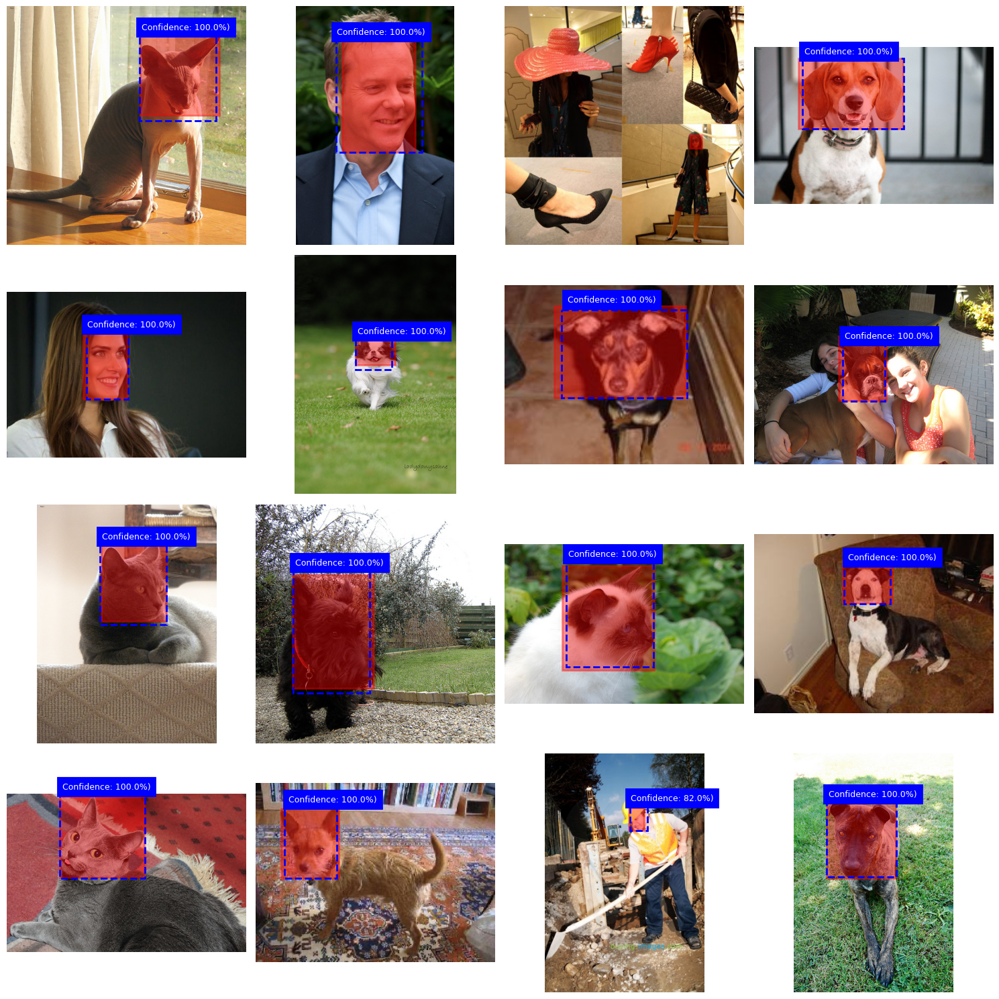

In [34]:
# evaluate RPN against TEST DATA
inds = np.random.choice(a = range(len(Y_test)), size = 16, replace = False)
plt.figure(figsize = (15,15))
for i in range(0, 16, 1):
    ax = plt.subplot(4, 4, i+1)
    show_RPN_performance(image = X_test[inds[i]], 
                         label = Y_test[inds[i]],
                         folder = '/datasets/', # NOTE that our image and label filenames are located in the dataset folder
                         RPN = RPN, 
                         extract_rpn_proposals_layer = extract_rpn_proposals_layer, 
                         params = params,
                         pred_color = 'blue', 
                         gt_color = 'red',
                         return_original_dimensions = True,
                         boxborderwidth = 2,
                         boxborderstyle = '--',
                         fontsize = 9,
                         labelcolor = 'white', 
                         labelbackgroundcolor = 'blue',
                         labelborderwidth = 2,
                         labelborderstyle = '-',
                         labelpadding = 5.0,
                         axisdrawn = False)
    pass
plt.tight_layout()
plt.show()

In [35]:
# once we are satisfied that the RPN network does a good enough job finding the ROI's, we freeze the weights of the RPN
# as we will now focus on classifying those ROI's
RPN.trainable = False
RPN.summary()

Model: "RPN"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 448, 448, 3)]     0         
                                                                 
 VGG16 (Functional)          (None, 28, 28, 512)       14714688  
                                                                 
 RPN_Head (RPN_heads)        ((None, 28, 28, 27, 1),   43741319  
                              (None, 28, 28, 27, 4))             
                                                                 
Total params: 58,456,007
Trainable params: 0
Non-trainable params: 58,456,007
_________________________________________________________________


### Classifying ROI proposals outputted by RPN
-----------------
From this point on, we have frozen the RPN part of the network. Furthermore, we are going to add a RPN decoding layer for decoding the RPN output and a classifier head to predict class labels for those outputted ROI's.

One option is to use a data generator that dynamically runs the image/annotation pairings through preprocessing, the RPN network, a decoder layer, and ROI extraction operations during training. This way, we do not have to store a lot in memory. However, it is relatively slow because of all the "preprocessing" before arriving at the ROI/ROI label pairings that are fed into the classifier network. On the other hand, the upside is that we do not have to compromise on a subset of ROI's and sample. We can train on all ROI's that the RPN can predict/find.

The second option is to do all this preprocessing beforehand and store the ROI's and their labels in memory. Eliminating all the work during data generation, speeds up the training tremendously. However, we are limited to the memory's capacity which might mean training on a smaller than representative sample of ROI's, which might make it difficult for the model to extract generalizable features.

In [36]:
# # OPTION 1.) -- HIGH COMPUTATIONAL COSTS & LOW MEMORY USAGE
# # This data generator runs images through the RPN network, extracts the ROI's (Regions of Interest) and proposed labels, 
# # creates batches and then feeds those batches to the classifier.
# class_gen = classifier_data_generator(images = X_train, 
#                                       labels = Y_train,
#                                       RPN = RPN, 
#                                       extract_rpn_proposals_layer = extract_rpn_proposals_layer,
#                                       roi_resolution = (128, 128),
#                                       params = params, 
#                                       augment_params = None, # if augment_params is None, no augmentation is applied
#                                       batch_size = 16) 
# rois, rois_lbl = class_gen.__getitem__(0)

# print('Batch ROI images: ', rois.shape)
# print('Batch ROI labels: ', rois_lbl.shape)

# plt.figure(figsize = (15,15))
# for i in range(0, 16, 1):
#     ax = plt.subplot(4, 4, i+1)
#     plt.imshow(rois[i]/255.)
#     plt.title('Target Label: ' + params['CLASSES'][int(rois_lbl[i])])

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [00:04<00:00, 20.74it/s]


Batch ROI images:  (93, 128, 128, 3)
Batch ROI labels:  (93,)


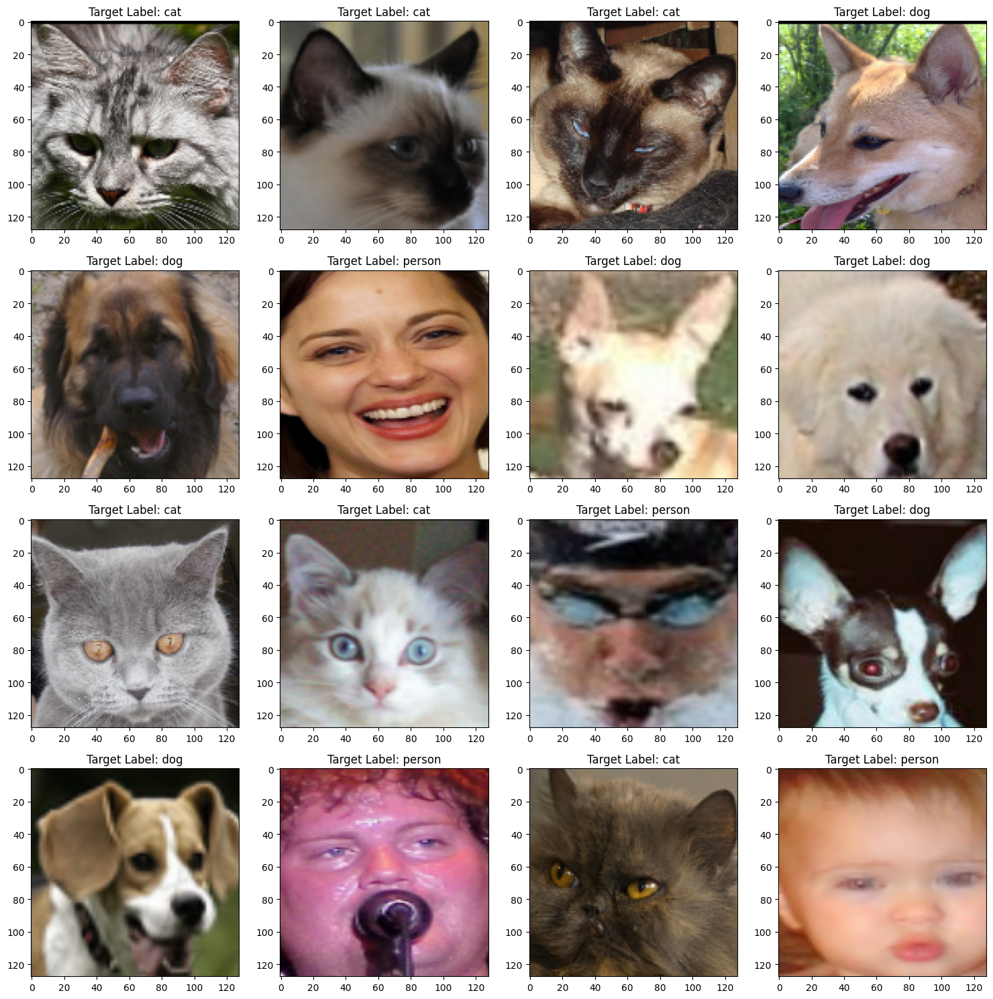

In [38]:
# OPTION 2.) -- LOWER COMPUTATIONAL COSTS (RELATIVE TO OPTION 1.) & HIGHER MEMORY USAGE
# Pre-load all the ROI's & target labels into memory before feeding them to the classifier.
# This only works if you have enough memory or are satisfied with sampling.
roi_imgs, roi_cls = preload_rois(i_max = 100, 
                                 X = X_train, 
                                 Y = Y_train,
                                 RPN = RPN, 
                                 extract_rpn_proposals_layer = extract_rpn_proposals_layer,
                                 resolution = params['ROI_RESOLUTION'], 
                                 params = params)

print('Batch ROI images: ', roi_imgs.shape)
print('Batch ROI labels: ', roi_cls.shape)

# inspect the test data ROI's extracted
plt.figure(figsize = (15,15))
for i in range(0, 16, 1):
    ax = plt.subplot(4, 4, i+1)
    plt.title('Target Label: ' + params['CLASSES'][int(roi_cls[i])])
    plt.imshow(roi_imgs[i]/255.)
    pass
plt.tight_layout()
plt.show()

In [37]:
###### CLASSIFIER FEATURE EXTRACTOR ########
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

feature_extractor = VGG16(include_top = False, 
                          weights = 'imagenet', 
                          input_shape = (params['ROI_RESOLUTION'][0], params['ROI_RESOLUTION'][1], params['CHANNELS']))

feature_extractor.trainable = False # we freeze the backbone's weights

###### OVERALL CLASSIFIER #######
i = Input([params['ROI_RESOLUTION'][0], params['ROI_RESOLUTION'][1], params['CHANNELS']], name = 'classifier_input')
x = tf.cast(i, tf.float32)
x = preprocess_input(x)
x = feature_extractor(x)
x = GlobalMaxPooling2D()(x)
x = Dense(units = 128, activation = "relu", name = "Dense_1")(x)
x = Dense(len(params['CLASSES']), activation = "softmax", name = "Dense_final")(x)

Classifier = Model(inputs=[i], outputs=[x], name = 'Classifier')

print(Classifier.summary())

Model: "Classifier"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 classifier_input (InputLaye  [(None, 128, 128, 3)]    0         
 r)                                                              
                                                                 
 tf.cast_1 (TFOpLambda)      (None, 128, 128, 3)       0         
                                                                 
 tf.__operators__.getitem_1   (None, 128, 128, 3)      0         
 (SlicingOpLambda)                                               
                                                                 
 tf.nn.bias_add_1 (TFOpLambd  (None, 128, 128, 3)      0         
 a)                                                              
                                                                 
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                        

In [38]:
# COMPILE CLASSIFIER
Classifier.compile(loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

# set up directory to store weights
if not os.path.exists('pretrained/weights/' + Classifier.name):
    os.makedirs('pretrained/weights/' + Classifier.name)
    pass

# construct a filename
filename = (Classifier.name + '_' +
            "".join(str(tuple(params['ROI_RESOLUTION']))).replace(", ", "X") + '_' + 
            str(params['CLASSES'][:]) + '_model_(' + 
            datetime.datetime.now().strftime("%x") + 
            ').h5').replace('\'', '').replace('/', '-').replace(', ', '_')
print('Model weights will be saved under: ')
print(filename)

# CALLBACKS
checkpoint = ModelCheckpoint(filepath = 'pretrained/weights/' + Classifier.name + '/' + filename,
                             monitor = "val_loss",
                             verbose = 0, 
                             save_best_only = True, 
                             save_weights_only = True)

early_stopping = EarlyStopping(monitor = "val_loss",
                               min_delta = 0,
                               patience = 5,
                               verbose = 1,
                               mode = "auto",
                               restore_best_weights = True)

Model weights will be saved under: 
Classifier_(128X128)_[cat_dog_person]_model_(07-10-24).h5


In [39]:
# # OPTION 1.) TRAINING USING A GENERATOR THAT DYNAMICALLY RUNS IMAGES THROUGH RPN NETWORK
# batch_size = 16

# Classifier.fit(classifier_data_generator(images = X_train, 
#                                          labels = Y_train,
#                                          RPN = RPN, 
#                                          extract_rpn_proposals_layer = extract_rpn_proposals_layer,
#                                          roi_resolution = (128, 128),
#                                          params = params, 
#                                          augment_params = None, # if augment_params is None, no augmentation is applied
#                                          batch_size = batch_size),
#                epochs = 10,
#                validation_data = classifier_data_generator(images = X_test, 
#                                                            labels = Y_test,
#                                                            RPN = RPN, 
#                                                            extract_rpn_proposals_layer = extract_rpn_proposals_layer,
#                                                            roi_resolution = (128, 128),
#                                                            params = params, 
#                                                            augment_params = None, # if augment_params is None, no augmentation is applied
#                                                            batch_size = batch_size),
#                 verbose = 1,
#                 callbacks = [checkpoint])

In [38]:
# OPTION 2.) TRAINING CLASSIFIER USING PRE-LOADED ROI'S AND TARGET LABELS
Classifier.fit(roi_imgs, 
               roi_cls, 
               batch_size = 32, 
               epochs = 10, 
               validation_split = 0.2,
               callbacks = [checkpoint])

Epoch 1/10
96/96 [==============================] - 3s 32ms/step - loss: 2.1663 - accuracy: 0.9468 - val_loss: 0.3351 - val_accuracy: 0.9857
Epoch 2/10
96/96 [==============================] - 2s 22ms/step - loss: 0.1426 - accuracy: 0.9928 - val_loss: 0.0849 - val_accuracy: 0.9896
Epoch 3/10
96/96 [==============================] - 2s 21ms/step - loss: 7.3101e-04 - accuracy: 1.0000 - val_loss: 0.0991 - val_accuracy: 0.9883
Epoch 4/10
96/96 [==============================] - 2s 21ms/step - loss: 8.8804e-05 - accuracy: 1.0000 - val_loss: 0.0901 - val_accuracy: 0.9909
Epoch 5/10
96/96 [==============================] - 2s 21ms/step - loss: 1.5078e-05 - accuracy: 1.0000 - val_loss: 0.0896 - val_accuracy: 0.9909
Epoch 6/10
96/96 [==============================] - 2s 21ms/step - loss: 5.3725e-06 - accuracy: 1.0000 - val_loss: 0.0891 - val_accuracy: 0.9909
Epoch 7/10
96/96 [==============================] - 2s 21ms/step - loss: 3.2697e-06 - accuracy: 1.0000 - val_loss: 0.0887 - val_accuracy: 

In [40]:
# Custom SAVE and LOAD (pre-)trained model weights
# Classifier.save_weights('pretrained/weights/Classifier/Classifier_(128X128)_[cat_dog_person]_model_(01-31-24)_1.h5')
Classifier.load_weights('pretrained/weights/Classifier/Classifier_(128X128)_[cat_dog_person]_model_(02-02-24).h5')

In [41]:
# create new classifier head (which consists of ROI extraction operations + the classifier network we just trained)
classifier_head = Classifier_Head(net = Classifier,
                                  roi_resolution = params['ROI_RESOLUTION'], 
                                  params = params,
                                  name = "Classifier")

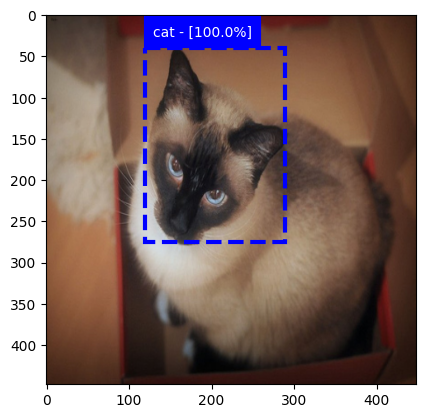

In [42]:
# check if the classifier head works...

# STEP 1: run our test image through our RPN & decode the output
test_roi = extract_rpn_proposals_layer(RPN([np.expand_dims(img, axis = 0)]))[1]

# STEP 2: run the RPN output (ROI's) through our classifier
test_class_scores = classifier_head([np.expand_dims(img, axis = 0), test_roi])

# STEP 3: dislay results...
for i in range(len(test_roi)):
    
    # draw bounding box
    draw_box(xmin = test_roi[i][1], 
             ymin = test_roi[i][0],
             width = test_roi[i][3] - test_roi[i][1], 
             height = test_roi[i][2] - test_roi[i][0], 
             color = 'blue',
             borderwidth = 3,
             borderstyle = '--',
             alpha = 'none',
             fill = False)
        
    # draw object label
    draw_box_label(xmin = int(test_roi[i][1]+5), 
                   ymin = int(test_roi[i][0]-5), 
                   label = params['CLASSES'][int(np.argmax(test_class_scores[i]))] + ' - [' + str(np.round(np.max(test_class_scores[i])*100.0,0)) + '%]',
                   fontsize = 10.0,
                   color = 'white', 
                   backgroundcolor = 'blue',
                   bordercolor = 'blue',
                   borderwidth = 3,
                   borderstyle = '-',
                   padding = 5.0)

plt.imshow(img/255.)
plt.show()

------------------------------------

## RPN + ROI Classifier = Faster R-CNN
Combining the Region Proposal Network (RPN) that predicts ROI's and the classifier head for classifying those ROI's, we arrive at a single-shot object detector. 

In [43]:
# Add the RPN and the classifier head together to create the single-shot detector (Faster R-CNN)
FasterRCNN = init_Faster_RCNN(RPN = RPN, 
                              extract_rpn_proposals_layer = extract_rpn_proposals_layer, 
                              classifier_head = classifier_head, 
                              params = params)
FasterRCNN.summary()

Model: "FasterRCNN"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input_Images (InputLayer)      [(None, 448, 448, 3  0           []                               
                                )]                                                                
                                                                                                  
 RPN (Functional)               [(None, 28, 28, 27,  58456007    ['Input_Images[0][0]']           
                                 1),                                                              
                                 (None, 28, 28, 27,                                               
                                 4)]                                                              
                                                                                         

### Evaluate Faster R-CNN Performance on Test Data

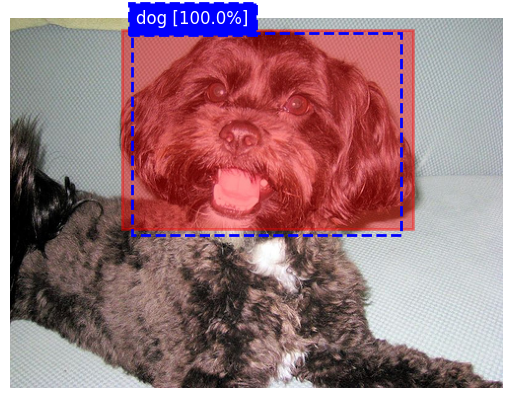

In [44]:
i = 4
show_FasterRCNN_prediction(image = X_test[i], 
                           label = Y_test[i],
                           folder = '/datasets/', # NOTE that our image and label filenames are located in the dataset folder
                           FasterRCNN = FasterRCNN, 
                           params = params,
                           pred_color = 'blue', 
                           gt_color = 'red',
                           return_original_dimensions = True,
                           boxborderwidth = 2,
                           boxborderstyle = '--',
                           fontsize = 12,
                           labelcolor = 'white', 
                           labelbackgroundcolor = 'blue',
                           labelborderwidth = 2,
                           labelborderstyle = '--',
                           labelpadding = 5.0,
                           axisdrawn = False)

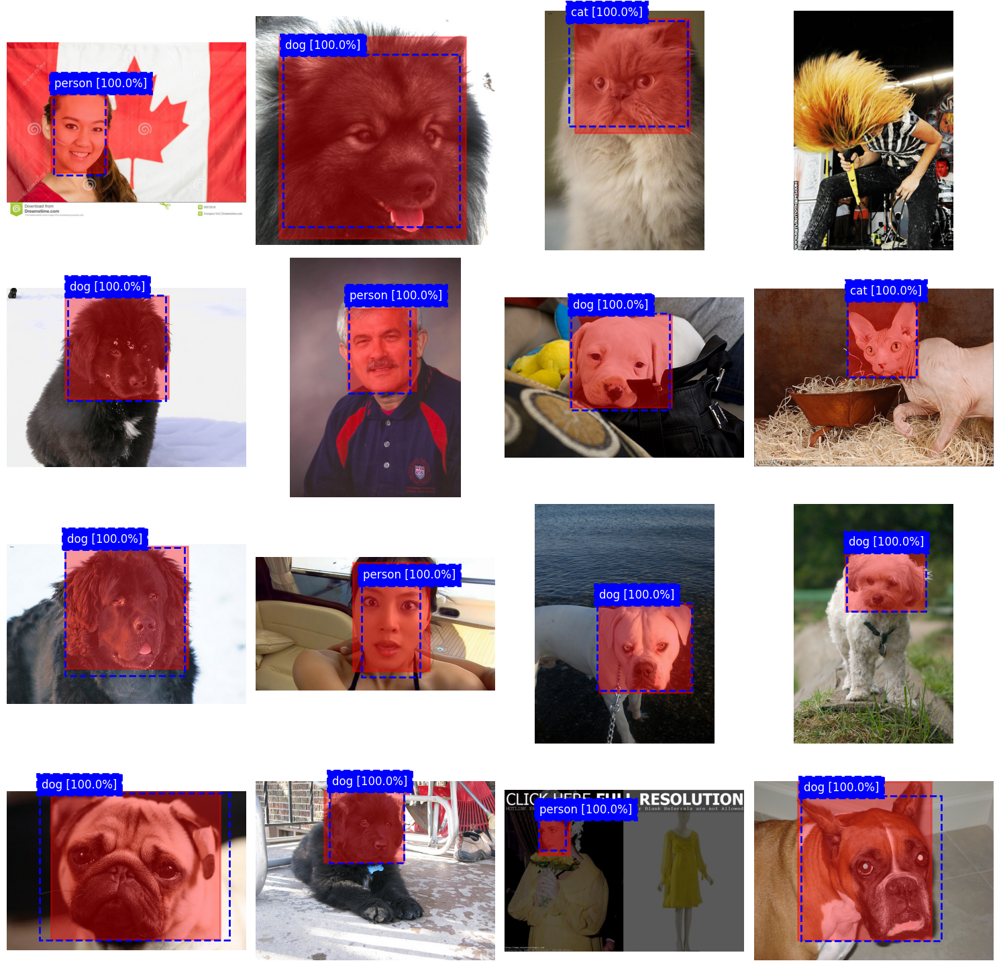

In [46]:
# inspect the test data ROI's extracted
inds = np.random.choice(a = range(len(Y_test)), size = 16, replace = False)
plt.figure(figsize = (15,15))
for i in range(0, 16, 1):
    ax = plt.subplot(4, 4, i+1) 
    show_FasterRCNN_prediction(image = X_test[inds[i]], 
                               label = Y_test[inds[i]],
                               folder = '/datasets/', # NOTE that our image and label filenames are located in the dataset folder
                               FasterRCNN = FasterRCNN, 
                               params = params,
                               pred_color = 'blue', 
                               gt_color = 'red',
                               return_original_dimensions = True,
                               boxborderwidth = 2,
                               boxborderstyle = '--',
                               fontsize = 12,
                               labelcolor = 'white', 
                               labelbackgroundcolor = 'blue',
                               labelborderwidth = 2,
                               labelborderstyle = '--',
                               labelpadding = 5.0,
                               axisdrawn = False)
    pass
plt.tight_layout()
plt.show()

------------------------

# Object Detection on New Data

At this point we are ready to use our object detector to test on completely new and "unseen" images and videos. Place the images and videos within the test folder and see the performance for yourself... 

### 1.) object detection on new images

In [47]:
# retrieve filenames of images in test folder
os.listdir(os.getcwd() + '/test/image/')

['test_1.jpg',
 'test_10.jpg',
 'test_11.jpg',
 'test_12.jpg',
 'test_13.jpg',
 'test_14.jpg',
 'test_15.jpg',
 'test_16.jpg',
 'test_17.jpg',
 'test_2.jpg',
 'test_3.jpg',
 'test_4.jpg',
 'test_5.jpg',
 'test_6.jpg',
 'test_7.jpg',
 'test_8.jpg',
 'test_9.jpg']

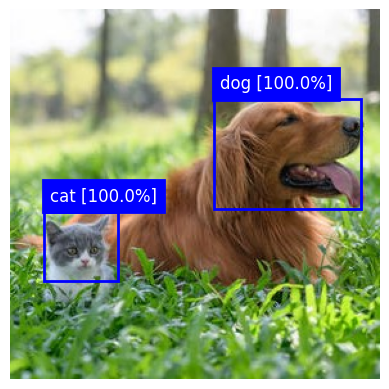

In [48]:
show_FasterRCNN_prediction(image = 'test_1.jpg', 
                           folder = '/test/image/', # NOTE: we are now looking for the images in the ../test/image/ folder
                           label = None, # NOTE: we do not have an annotation file for this image
                           FasterRCNN = FasterRCNN, 
                           params = params,
                           pred_color = 'blue', 
                           gt_color = 'red',
                           return_original_dimensions = True,
                           boxborderwidth = 2,
                           boxborderstyle = '-',
                           fontsize = 12,
                           labelcolor = 'white', 
                           labelbackgroundcolor = 'blue',
                           labelborderwidth = 2,
                           labelborderstyle = '-',
                           labelpadding = 5.0,
                           axisdrawn = False)

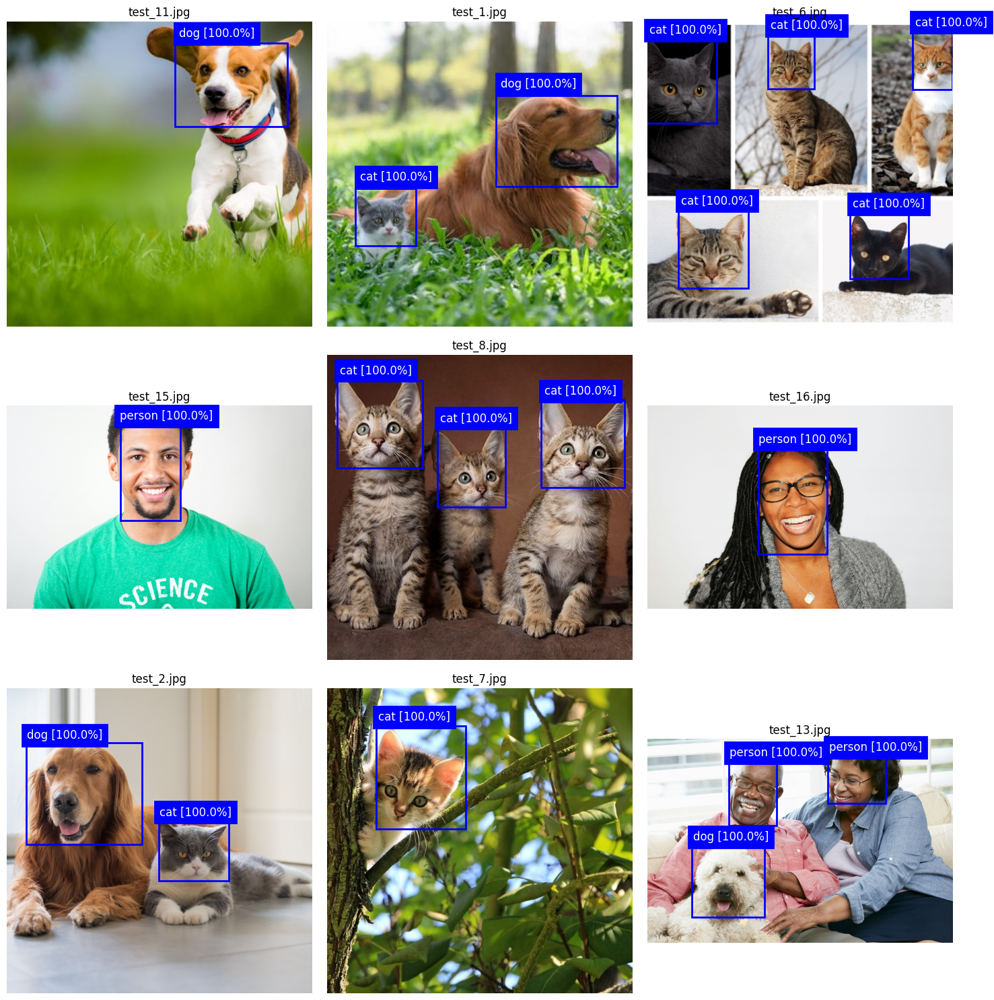

In [67]:
# randomly sample from test folder
new_img_filenames = os.listdir(os.getcwd() + '/test/image/')
inds = np.random.choice(a = range(len(new_img_filenames)), size = 9, replace = False)
plt.figure(figsize = (15,15))
for i in range(0, 9, 1):
    ax = plt.subplot(3, 3, i+1)
    
    plt.title(new_img_filenames[inds[i]])
    show_FasterRCNN_prediction(image = new_img_filenames[inds[i]], 
                               label = None, # NOTE: we do not have an annotation file for this image
                               folder = '/test/image/', # NOTE: we are now looking for the images in the ../test/image/ folder
                               FasterRCNN = FasterRCNN, 
                               params = params,
                               pred_color = 'blue', 
                               gt_color = 'red',
                               return_original_dimensions = True,
                               boxborderwidth = 2,
                               boxborderstyle = '-',
                               fontsize = 12,
                               labelcolor = 'white', 
                               labelbackgroundcolor = 'blue',
                               labelborderwidth = 2,
                               labelborderstyle = '-',
                               labelpadding = 5.0,
                               axisdrawn = False)
    pass
plt.tight_layout()
plt.show()

### 2.) object detection on new videos

In [63]:
# retrieve filenames of videos in test folder
os.listdir(os.getcwd() + '/test/video/')

['a-couple-of-cats-in-the-snow.mp4',
 'cat-meowing-outside-the-window.mp4',
 'corgi-running-through-the-grass.mp4',
 'friends-walk-down-the-street.mp4',
 'man-and-woman-working.mp4',
 'man-and-woman.mp4',
 'man-behind-laptop.mp4',
 'results',
 'two-puppies-side-by-side.mp4',
 'woman-pets-her-dogs.mp4',
 'woman-with-her-two-huskies.mp4']

In [62]:
# perform object detection on videos (see "results" subfolder for output)
bbox_col = (255, 0, 0) # blue
lbl_col = (255, 255, 255) # white

frame_inference_times = predict_video(filename = 'woman-with-her-two-huskies.mp4', 
                                      FasterRCNN = FasterRCNN,
                                      params = params,
                                      folder = 'test/video/',
                                      fps = 25,
                                      box_border_color = bbox_col,
                                      box_border_thickness = 2,
                                      label_font = cv.FONT_HERSHEY_SIMPLEX,
                                      label_font_size = 1,
                                      label_font_color = lbl_col,
                                      label_font_thickness = 2,
                                      label_border_color = bbox_col,
                                      label_border_thickness = 2,
                                      label_background_color = bbox_col)

Creating video (.mp4)...


100%|████████████████████████████████████████████████████████████████████████████████| 182/182 [00:13<00:00, 13.10it/s]

Done.


## Final Remarks
-----------------
### Further Improvements
Evaluating the results of our model, we can clearly see that it has some problems with accurately detecting smaller objects. This is at least in part caused by the distortion that happens when training and test images are resized to model input dimensions. 

I suspect that a combination of more consistent training/test image dimensions, together with upping the resolution, and a more densely populated grid for anchors, would improve model performance.